# Generative Dogs

In [38]:
import pandas as pd
import numpy as np
from PIL import Image
import os

import matplotlib.pyplot as plt
import torch
from torch import nn, optim
import torch.nn.functional as F
from torchvision import datasets, transforms
from torchvision.utils import save_image
import seaborn as sns
import torchvision.utils as vutils

from collections import defaultdict
from tqdm import tqdm

import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML


## Data Exploration

There are 20579 pictures of dogs.


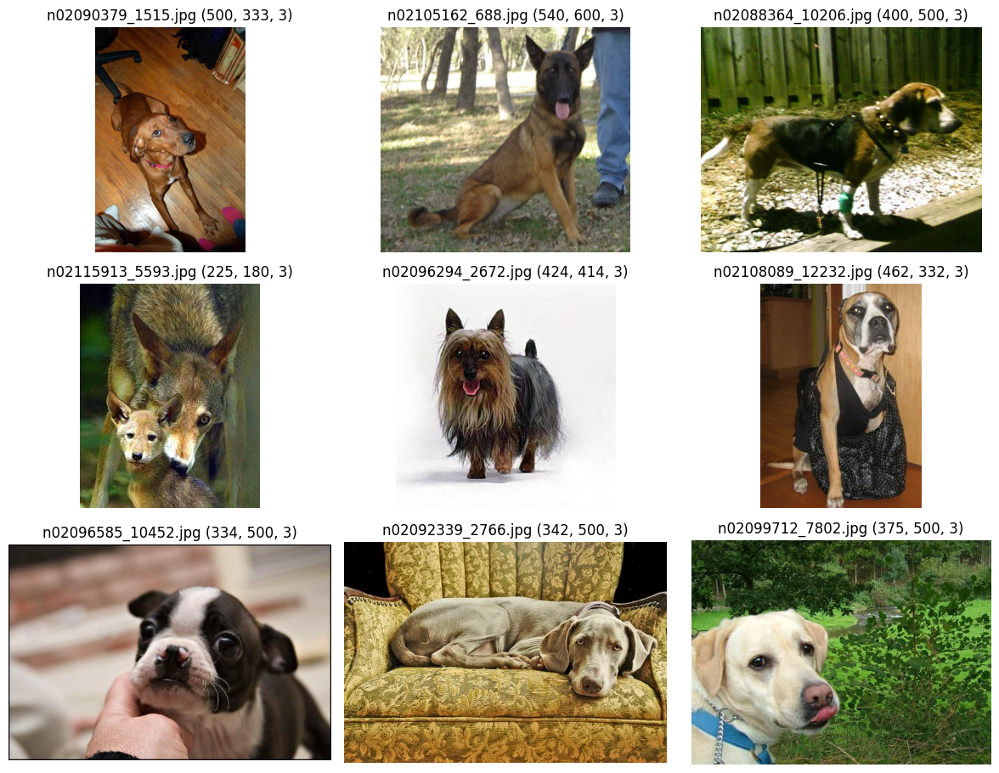

In [2]:
input_dir = 'input'
PATH = 'input/all-dogs/'
images = os.listdir(PATH)
print(f'There are {len(os.listdir(PATH))} pictures of dogs.')

fig, axes = plt.subplots(nrows=3, ncols=3, figsize=(12,10))

for indx, axis in enumerate(axes.flatten()):
    rnd_indx = np.random.randint(0, len(os.listdir(PATH)))
    # https://matplotlib.org/users/image_tutorial.html
    img = plt.imread(PATH + images[rnd_indx])
    imgplot = axis.imshow(img)
    axis.set_title(images[rnd_indx]+' '+str(img.shape))
    axis.set_axis_off()
plt.tight_layout(rect=[0, 0.03, 1, 0.95])

In [3]:
import shutil
destination_folder = input_dir + '/dogs'

breeds_name = defaultdict(list)
for code_and_name in os.listdir(input_dir + '/Annotation'):
    try:
        breed_code, breed_name = code_and_name.split('-')
        breeds_name[breed_code].append(breed_name) 
    except:
        breed_code = code_and_name.split('-')[0]
        breed_name = '-'.join(code_and_name.split('-')[1:])
        breeds_name[breed_code].append(breed_name)

breed_dicts = defaultdict(list)
for code_and_index in os.listdir(PATH):
    breed_code, pict_indx = code_and_index.split('_')
    breed_name = breeds_name[breed_code][0]
    breed_dicts[breed_name].append(pict_indx) 
    
    # Create the class folder in the destination folder (if it doesn't exist)
    class_folder = os.path.join(destination_folder, breed_code)
    os.makedirs(class_folder, exist_ok=True)
    
    # Move the image file to the corresponding class folder
    source_path = os.path.join(PATH, code_and_index)
    destination_path = os.path.join(class_folder, pict_indx)
    shutil.copy(source_path, destination_path)

There are 120 breeds


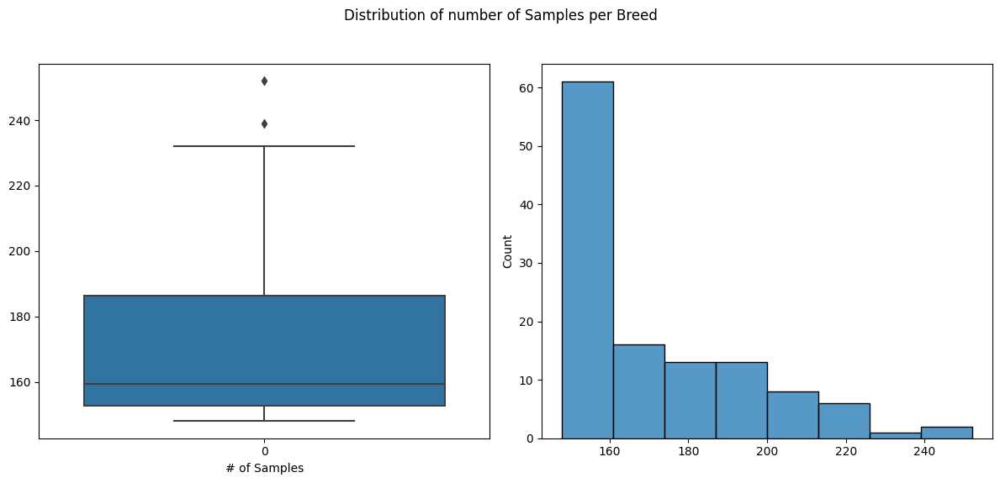

Top 10 Dog Breeds by the Data Given : ['Maltese_dog' 'Afghan_hound' 'Scottish_deerhound' 'Pomeranian'
 'Irish_wolfhound' 'Samoyed' 'Bernese_mountain_dog' 'Shih-Tzu'
 'Great_Pyrenees' 'Leonberg']


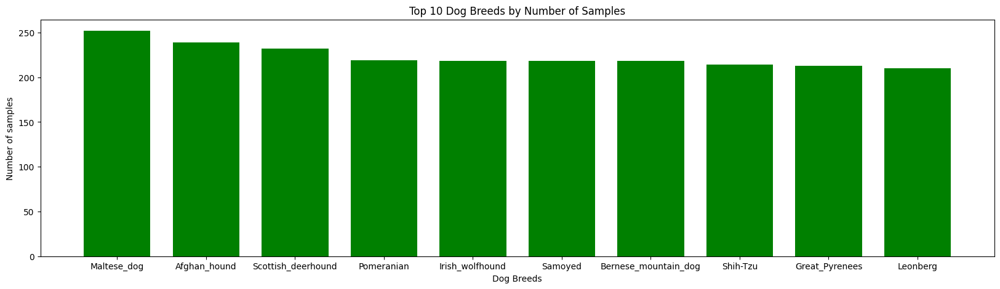

In [4]:
df_breeds = pd.DataFrame.from_dict(breed_dicts, orient='index').T
print(f'There are {df_breeds.shape[1]} breeds')

fig = plt.figure(figsize=(12, 6))
fig.suptitle('Distribution of number of Samples per Breed')
fig.add_subplot(121)
sns.boxplot(df_breeds.shape[0] - df_breeds.isnull().sum())
plt.xlabel('# of Samples')
#plt.xticks([])
fig.add_subplot(122)
sns.histplot(df_breeds.shape[0] - df_breeds.isnull().sum())
plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()

df = df_breeds.count().reset_index()
df = df.sort_values(by=[0], ascending = False)
breeds = df[:10]['index'].values
values = df[:10][0].values

print(f'Top 10 Dog Breeds by the Data Given : {breeds}')
fig = plt.figure(figsize = (20, 5))
 
# creating the bar plot
plt.bar(breeds, values, color ='green', width = 0.75)
 
plt.xlabel("Dog Breeds")
plt.ylabel("Number of samples")
plt.title("Top 10 Dog Breeds by Number of Samples")
plt.show()

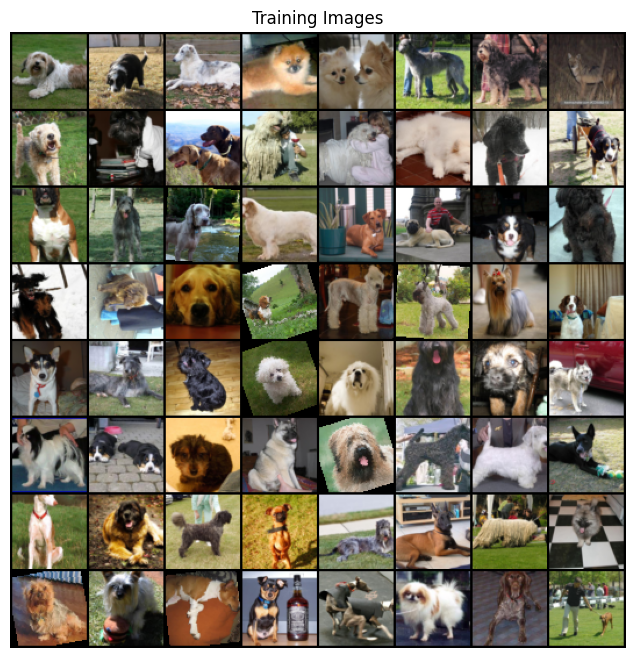

In [24]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

batch_size = 128
image_size = 64

random_transforms = [transforms.ColorJitter(), transforms.RandomRotation(degrees=20)]
transform = transforms.Compose([transforms.Resize(image_size),
                                transforms.CenterCrop(image_size),
                                transforms.RandomHorizontalFlip(p=0.5),
                                transforms.RandomApply(random_transforms, p=0.2),
                                transforms.ToTensor(),
                                transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))])

train_data = datasets.ImageFolder('input/dogs/', transform=transform)
train_loader = torch.utils.data.DataLoader(train_data, shuffle=True,
                                           batch_size=batch_size)
                                           
imgs, label = next(iter(train_loader))

# Plot some training images
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(imgs.to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

imgs = imgs.numpy().transpose(0, 2, 3, 1)

In [25]:
def show_generated_img():
    noise = torch.randn(1, z_dim, 1, 1, device=device)
    gen_image = netG(noise).to("cpu").clone().detach().squeeze(0)
    gen_image = gen_image.numpy().transpose(1, 2, 0)
    plt.imshow((gen_image+1)/2)
    plt.show()

## DCGAN

In [37]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [19]:
class Generator(nn.Module):
    def __init__(self, z_dim, channels_img, features_g):
        super(Generator, self).__init__()
        self.gen = nn.Sequential(
            # Input: N x z_dim x 1 x 1
            nn.ConvTranspose2d(z_dim, features_g * 16, kernel_size=4, stride=1, padding=0),  #multipler of n_features indicates the complexity of the model 
            nn.BatchNorm2d(features_g * 16),
            nn.ReLU(),

            # N x features_g*16 x 4 x 4
            nn.ConvTranspose2d(features_g * 16, features_g * 8, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(features_g * 8),
            nn.ReLU(),

            # N x features_g*8 x 8 x 8
            nn.ConvTranspose2d(features_g * 8, features_g * 4, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(features_g * 4),
            nn.ReLU(),

            # N x features_g*4 x 16 x 16
            nn.ConvTranspose2d(features_g * 4, features_g * 2, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(features_g * 2),
            nn.ReLU(),

            # N x features_g*2 x 32 x 32
            nn.ConvTranspose2d(features_g * 2, channels_img, kernel_size=4, stride=2, padding=1),
            # output: N x channels_img x 64 x 64
            nn.Tanh(),
        )

    def forward(self, x):
        return self.gen(x)


class Discriminator(nn.Module):
    def __init__(self, channels_img, features_d):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            # Input: N x channels_img x 64 x 64
            nn.Conv2d(channels_img, features_d, kernel_size=4, stride=2, padding=1),
            nn.LeakyReLU(0.2),

            # N x features_d x 32 x 32
            nn.Conv2d(features_d, features_d * 2, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(features_d * 2),
            nn.LeakyReLU(0.2),

            # N x features_d*2 x 16 x 16
            nn.Conv2d(features_d * 2, features_d * 4, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(features_d * 4),
            nn.LeakyReLU(0.2),

            # N x features_d*4 x 8 x 8
            nn.Conv2d(features_d * 4, features_d * 8, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(features_d * 8),
            nn.LeakyReLU(0.2),

            # N x features_d*8 x 4 x 4
            nn.Conv2d(features_d * 8, 1, kernel_size=4, stride=2, padding=0),
            # output: N x 1 x 1 x 1
            nn.Sigmoid(),
        )

    def forward(self, x):
        return self.disc(x).view(-1, 1)

In [28]:
lr = 0.001
beta1 = 0.5

z_dim = 100 #the dimensionality of the input noise vector
channels_img = 3 # number of output image channels
features_g = 64 # a base number of features (scaled up in ealier layers, scaled down in later layers)
features_d = 48

netG = Generator(z_dim, channels_img, features_g).to(device)
netD = Discriminator(channels_img, features_d).to(device)
netG.apply(weights_init)
netD.apply(weights_init)

print(netG)
print(netD)
criterion = nn.BCELoss()

optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

fixed_noise = torch.randn(25, z_dim, 1, 1, device=device)

real_label = 0.9
fake_label = 0
batch_size = train_loader.batch_size


epochs = 100
step = 0

Generator(
  (gen): Sequential(
    (0): ConvTranspose2d(100, 1024, kernel_size=(4, 4), stride=(1, 1))
    (1): BatchNorm2d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
    (3): ConvTranspose2d(1024, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (4): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU()
    (6): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (7): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU()
    (9): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (10): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU()
    (12): ConvTranspose2d(128, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (13): Tanh()
  )
)
Discriminator(
  (disc): Sequential(
    (0): Conv2d(3, 48, kernel_size=(4, 4), stride=(2, 2), padding=

In [35]:
img_list = []
G_losses = []
D_losses = []
iters = 0

for epoch in range(epochs):
    for i, (real_images, train_labels) in enumerate(train_loader):
        netD.zero_grad()
        real_images = real_images.to(device)
        batch_size = real_images.size(0)
        labels = torch.full((batch_size, 1), real_label, device=device)

        output = netD(real_images)
        errD_real = criterion(output, labels)
        errD_real.backward()
        D_x = output.mean().item()

        noise = torch.randn(batch_size, z_dim, 1, 1, device=device)
        fake = netG(noise)
        labels.fill_(fake_label)
        output = netD(fake.detach())
        errD_fake = criterion(output, labels)
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        errD = errD_real + errD_fake
        optimizerD.step()

        netG.zero_grad()
        labels.fill_(real_label)  # fake labels are real for generator cost
        output = netD(fake)
        errG = criterion(output, labels)
        errG.backward()
        D_G_z2 = output.mean().item()
        optimizerG.step()
        
        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, epochs, i, len(train_loader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == epochs-1) and (i == len(train_loader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1
        
        

[0/100][0/161]	Loss_D: 1.2811	Loss_G: 1.9403	D(x): 0.5669	D(G(z)): 0.4200 / 0.1512
[0/100][50/161]	Loss_D: 1.1210	Loss_G: 1.9399	D(x): 0.6036	D(G(z)): 0.3501 / 0.1514
[0/100][100/161]	Loss_D: 1.4232	Loss_G: 2.0248	D(x): 0.4930	D(G(z)): 0.4252 / 0.1333
[0/100][150/161]	Loss_D: 1.1576	Loss_G: 3.4971	D(x): 0.7233	D(G(z)): 0.4779 / 0.0296
[1/100][0/161]	Loss_D: 0.8912	Loss_G: 1.9185	D(x): 0.6390	D(G(z)): 0.2871 / 0.1393
[1/100][50/161]	Loss_D: 2.7505	Loss_G: 1.8377	D(x): 0.0828	D(G(z)): 0.0224 / 0.2046
[1/100][100/161]	Loss_D: 1.6047	Loss_G: 3.0779	D(x): 0.7638	D(G(z)): 0.6375 / 0.0503
[1/100][150/161]	Loss_D: 1.1628	Loss_G: 1.4945	D(x): 0.5615	D(G(z)): 0.3913 / 0.2137
[2/100][0/161]	Loss_D: 1.1798	Loss_G: 1.2093	D(x): 0.5260	D(G(z)): 0.3527 / 0.2848
[2/100][50/161]	Loss_D: 1.0076	Loss_G: 2.3423	D(x): 0.5955	D(G(z)): 0.2867 / 0.0852
[2/100][100/161]	Loss_D: 0.6467	Loss_G: 2.0166	D(x): 0.7224	D(G(z)): 0.1835 / 0.1206
[2/100][150/161]	Loss_D: 0.6996	Loss_G: 2.2154	D(x): 0.6866	D(G(z)): 0.193

### Visualize the Loss duration Training

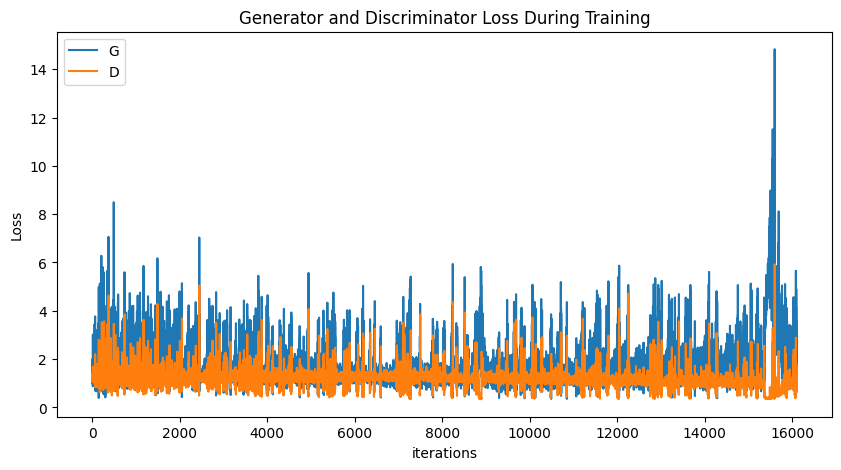

In [39]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

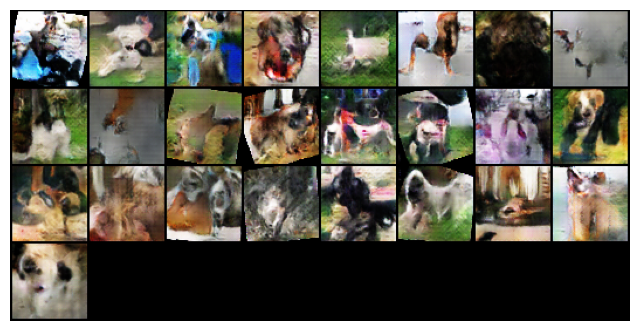

In [40]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

### Save Output Images

In [42]:
if not os.path.exists('dcgan_output_images'):
    os.mkdir('dcgan_output_images')
im_batch_size = 50
n_images=10000
for i_batch in range(0, n_images, im_batch_size):
    gen_z = torch.randn(im_batch_size, 100, 1, 1, device=device)
    gen_images = netG(gen_z)
    images = gen_images.to("cpu").clone().detach()
    images = images.numpy().transpose(0, 2, 3, 1)
    for i_image in range(gen_images.size(0)):
        save_image(gen_images[i_image, :, :, :], os.path.join('dcgan_output_images', f'image_{i_batch+i_image:05d}.png'))


In [43]:
shutil.make_archive('dcgan_output_images', 'zip', 'dcgan_output_images')

'/home/lily/Projects/Kaggle/dog_gan/dcgan_output_images.zip'

## DCGAN but with Relativistic Loss
- Instead of using Binary Cross Entropy Loss to calculate loss for both Generator and Discriminator, <b>Relativistic Loss<b> is used.

In [44]:
class Generator(nn.Module):
    def __init__(self, z_dim, channels_img, features_g):
        super(Generator, self).__init__()
        self.gen = nn.Sequential(
            # Input: N x z_dim x 1 x 1
            nn.ConvTranspose2d(z_dim, features_g * 32, kernel_size=4, stride=1, padding=0, bias=False),
            nn.BatchNorm2d(features_g * 32),
            nn.ReLU(inplace=True),

            nn.ConvTranspose2d(features_g * 32, features_g * 16, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(features_g * 16),
            nn.ReLU(inplace=True),

            nn.ConvTranspose2d(features_g * 16, features_g * 8, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(features_g * 8),
            nn.ReLU(inplace=True),
            
            nn.ConvTranspose2d(features_g * 8, features_g * 4, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(features_g * 4),
            nn.ReLU(inplace=True),

            nn.ConvTranspose2d(features_g * 4, features_g * 2, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(features_g * 2),
            nn.ReLU(inplace=True),

            nn.ConvTranspose2d(features_g * 2, channels_img, kernel_size=3, stride=1, padding=1),
            nn.Tanh()
        )
        
    def forward(self, x):
        return self.gen(x)

class Discriminator(nn.Module):
    def __init__(self, channels_img, features_d):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            # Input: N x channels_img x 64 x 64
            nn.Conv2d(channels_img, features_d, kernel_size=4, stride=2, padding=1),
            nn.LeakyReLU(0.2),

            # N x features_d x 32 x 32
            nn.Conv2d(features_d, features_d * 2, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(features_d * 2),
            nn.LeakyReLU(0.2),

            # N x features_d*2 x 16 x 16
            nn.Conv2d(features_d * 2, features_d * 4, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(features_d * 4),
            nn.LeakyReLU(0.2),

            # N x features_d*4 x 8 x 8
            nn.Conv2d(features_d * 4, features_d * 8, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(features_d * 8),
            nn.LeakyReLU(0.2),

            # N x features_d*8 x 4 x 4
            nn.Conv2d(features_d * 8, 1, kernel_size=4, stride=1, padding=0),
            # output: N x 1 x 1 x 1
        )

    def forward(self, x):
        return self.disc(x).view(-1, 1)

In [45]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

lr = 0.001
beta1 = 0.5

z_dim = 100 #the dimensionality of the input noise vector
channels_img = 3 # number of output image channels
features_g = 64 # a base number of features (scaled up in ealier layers, scaled down in later layers)
features_d = 32

netG = Generator(z_dim, channels_img, features_g).to(device)
netD = Discriminator(channels_img, features_d).to(device)
netG.apply(weights_init)
netD.apply(weights_init)

print(netG)
print(netD)

optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

fixed_noise = torch.randn(25, z_dim, 1, 1, device=device)

real_label = 0.9
fake_label = 0
batch_size = train_loader.batch_size


epochs = 100
step = 0

Generator(
  (gen): Sequential(
    (0): ConvTranspose2d(100, 2048, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(2048, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(2048, 1024, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(1024, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Bat

In [46]:
img_list = []
G_losses = []
D_losses = []
iters = 0

for epoch in range(epochs):
    for i, (real_images, train_labels) in enumerate(train_loader):
        netD.zero_grad()
        real_images = real_images.to(device)
        batch_size = real_images.size(0)
        labels = torch.full((batch_size, 1), real_label, device=device)
        outputR = netD(real_images)
        
        noise = torch.randn(batch_size, z_dim, 1, 1, device=device)
        fake = netG(noise)
        outputF = netD(fake.detach())
        errD = (torch.mean((outputR - torch.mean(outputF) - labels) ** 2) + 
                torch.mean((outputF - torch.mean(outputR) + labels) ** 2))/2
        errD.backward(retain_graph=True)
        optimizerD.step()

        netG.zero_grad()
        outputF = netD(fake)
        errG = (torch.mean((outputR - torch.mean(outputF) + labels) ** 2) +
                torch.mean((outputF - torch.mean(outputR) - labels) ** 2))/2
        errG.backward()
        optimizerG.step()
        
        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f'
                  % (epoch, epochs, i, len(train_loader),
                     errD.item(), errG.item()))

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == epochs-1) and (i == len(train_loader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

[0/100][0/161]	Loss_D: 1.7398	Loss_G: 108.8022
[0/100][50/161]	Loss_D: 27.2372	Loss_G: 72.7389
[0/100][100/161]	Loss_D: 0.5264	Loss_G: 2.4341
[0/100][150/161]	Loss_D: 0.4593	Loss_G: 2.3050
[1/100][0/161]	Loss_D: 0.8754	Loss_G: 2.1414
[1/100][50/161]	Loss_D: 0.6089	Loss_G: 1.8580
[1/100][100/161]	Loss_D: 0.4580	Loss_G: 2.3032
[1/100][150/161]	Loss_D: 0.4121	Loss_G: 2.5321
[2/100][0/161]	Loss_D: 0.4518	Loss_G: 2.4419
[2/100][50/161]	Loss_D: 0.3859	Loss_G: 2.1640
[2/100][100/161]	Loss_D: 0.2562	Loss_G: 2.7597
[2/100][150/161]	Loss_D: 0.6135	Loss_G: 1.8780
[3/100][0/161]	Loss_D: 0.6073	Loss_G: 2.1437
[3/100][50/161]	Loss_D: 0.7201	Loss_G: 2.4671
[3/100][100/161]	Loss_D: 0.5347	Loss_G: 1.6358
[3/100][150/161]	Loss_D: 0.7747	Loss_G: 2.0584
[4/100][0/161]	Loss_D: 0.3447	Loss_G: 2.2219
[4/100][50/161]	Loss_D: 1.0877	Loss_G: 1.4862
[4/100][100/161]	Loss_D: 0.6729	Loss_G: 1.3000
[4/100][150/161]	Loss_D: 0.6478	Loss_G: 1.5620
[5/100][0/161]	Loss_D: 0.8591	Loss_G: 1.2454
[5/100][50/161]	Loss_D: 0.

### Visualize the Loss duration Training

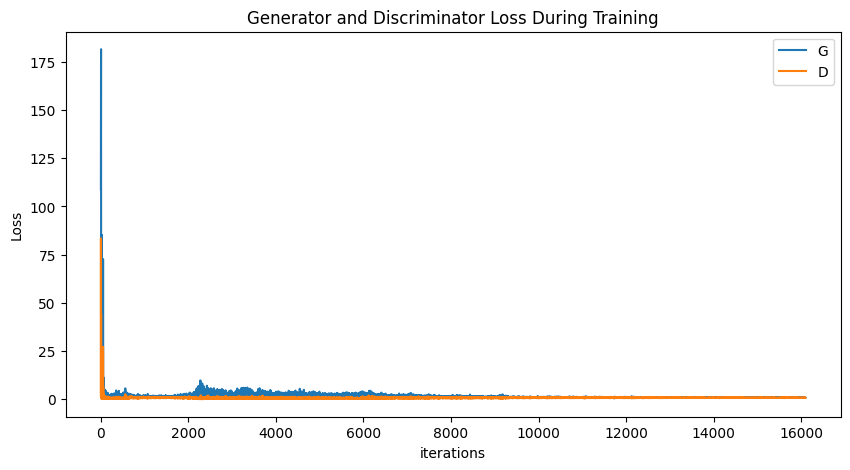

In [47]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

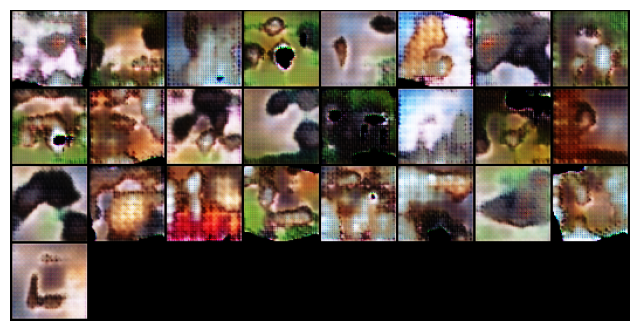

In [48]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

### Save Output Images

In [49]:
if not os.path.exists('dcgan_1_output_images'):
    os.mkdir('dcgan_1_output_images')
im_batch_size = 50
n_images=10000
for i_batch in range(0, n_images, im_batch_size):
    gen_z = torch.randn(im_batch_size, 100, 1, 1, device=device)
    gen_images = netG(gen_z)
    images = gen_images.to("cpu").clone().detach()
    images = images.numpy().transpose(0, 2, 3, 1)
    for i_image in range(gen_images.size(0)):
        save_image(gen_images[i_image, :, :, :], os.path.join('dcgan_1_output_images', f'image_{i_batch+i_image:05d}.png'))
        
shutil.make_archive('dcgan_1_output_images', 'zip', 'dcgan_1_output_images')

'/home/lily/Projects/Kaggle/dog_gan/dcgan_1_output_images.zip'

I tried two model training. The first one with BCE Loss and the second one with Relativistic Loss.
According to the my readings on the papers. Relativistic loss should be better. I would try to train more for future work.

### References
https://www.kaggle.com/competitions/generative-dog-images/overview <br>
https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html